## Частотный анализ изображений

In [1]:
# Imports
from skimage.io import imread, imsave, imshow
from skimage import img_as_float, img_as_ubyte
from skimage.color import rgb2gray
from skimage import filters, transform

import numpy as np

import matplotlib.pyplot as plt

import math

import copy

#### Подготовка изображение для экспериментов с гауссовской и лапласовской пирамидой. 

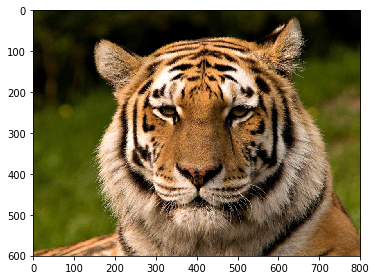

In [2]:
img = img_as_float(imread('https://stepik.org/media/attachments/lesson/58180/tiger-color.png'))
imshow(img)

#### Построение гауссовской пирамиды

In [3]:
max_pix = 1

In [4]:
def get_gauss_pyramide(img, sigma=0.3,n_layers=5):
    imgs = [img]
    
    for i in range(n_layers-1):
        # Применяем фильр гауса к последнему элементу списка
        
        img_h = filters.gaussian(imgs[-1], sigma=sigma, multichannel=True)
        img_h = np.clip(img_h, 0, max_pix)
        
        # Потом добавляем в конец то, что получилось
        imgs.append(img_h)
        
    return imgs

Для
$\sigma=0.33$

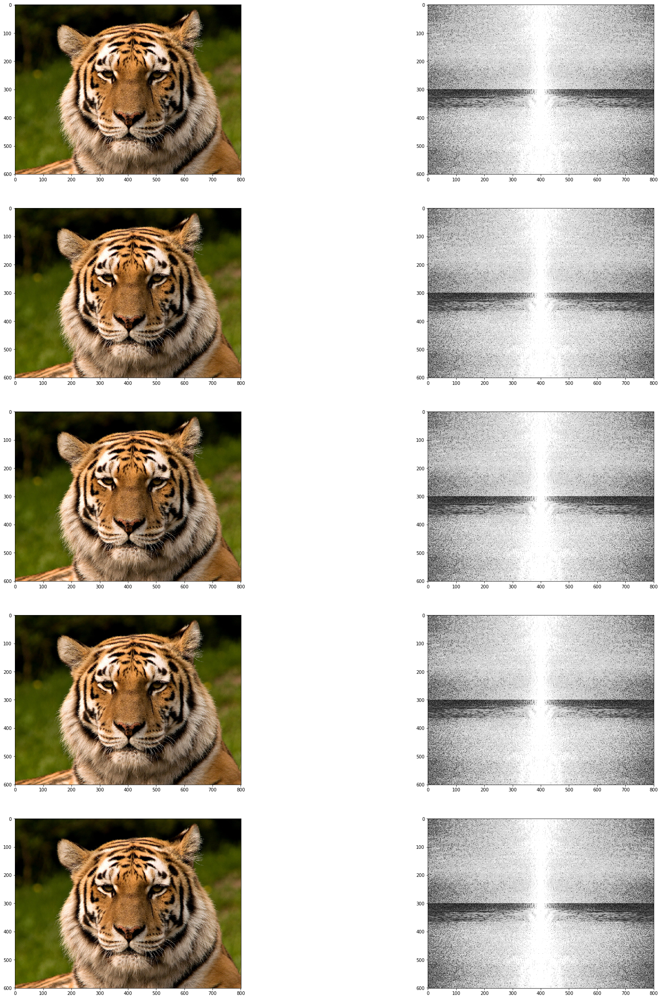

In [5]:
imgs = get_gauss_pyramide(img, 0.33, 5)

f, ax = plt.subplots(5, 2, figsize=(30, 40))

for i, curr_img in enumerate(imgs):
    freq = np.log(1 + np.abs(np.fft.fftshift(np.fft.fft2(curr_img))))
    freq = np.clip(freq, 0, max_pix)
    ax[i, 0].imshow(curr_img)
    ax[i, 1].imshow(rgb2gray(freq), cmap='gray')

Для
$\sigma=0.66$

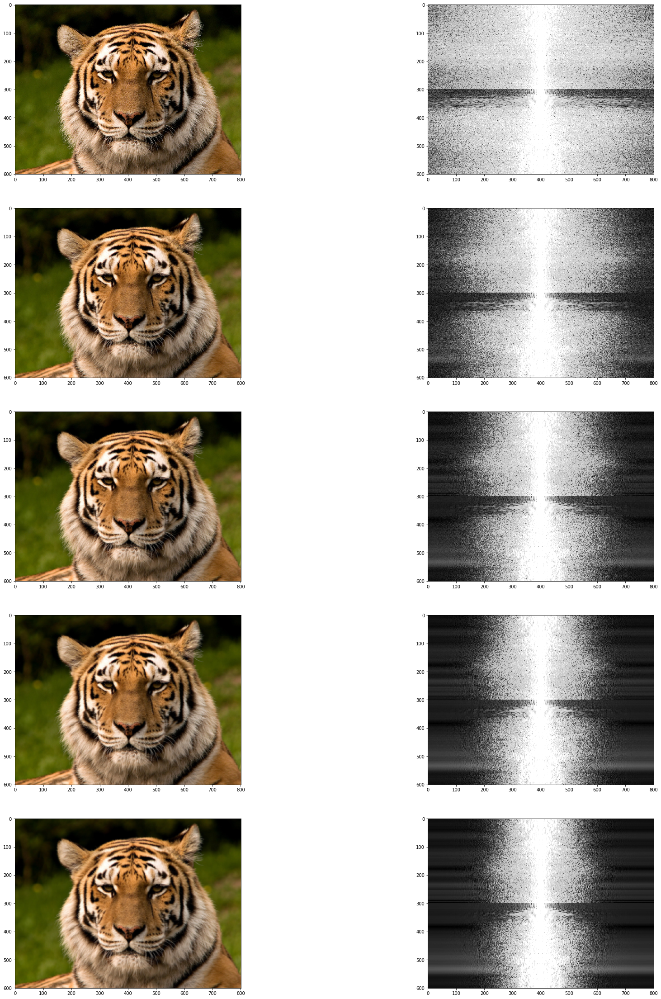

In [6]:
imgs = get_gauss_pyramide(img, 0.66, 5)

f, ax = plt.subplots(5, 2, figsize=(30, 40))

for i, curr_img in enumerate(imgs):
    freq = np.log(1 + np.abs(np.fft.fftshift(np.fft.fft2(curr_img))))
    freq = np.clip(freq, 0, max_pix)
    ax[i, 0].imshow(curr_img)
    ax[i, 1].imshow(rgb2gray(freq), cmap='gray')

Для
$\sigma=2$

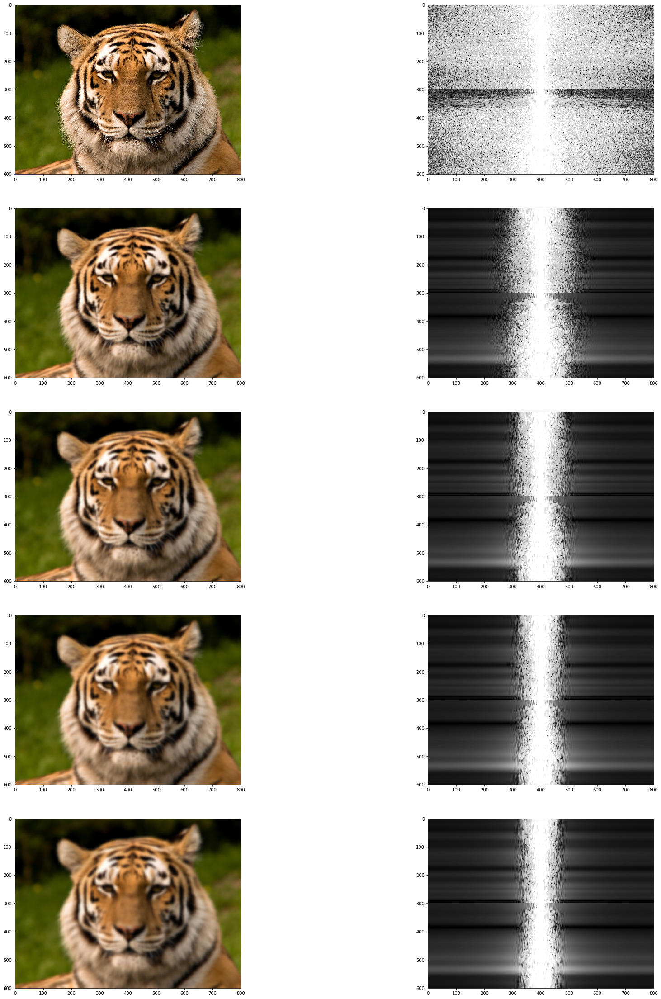

In [7]:
imgs = get_gauss_pyramide(img, 2, 5)

f, ax = plt.subplots(5, 2, figsize=(30, 40))

for i, curr_img in enumerate(imgs):
    freq = np.log(1 + np.abs(np.fft.fftshift(np.fft.fft2(curr_img))))
    freq = np.clip(freq, 0, max_pix)
    ax[i, 0].imshow(curr_img)
    ax[i, 1].imshow(rgb2gray(freq), cmap='gray')

Невооруженным глазом видно, что каждое последующее изображение в пирамиде все больше и больше размывается, а амплитуды частот изображений пирамиды сужается

#### Лапласовская пирамида

In [5]:
def get_laplas_pyramide(img, sigma=0.3, n_layers=5):
    G_pyramide = get_gauss_pyramide(img, sigma, n_layers)
    
    L_pyramide = [np.clip(G_pyramide[i] - G_pyramide[i+1], 0, max_pix) for i in range(n_layers-1)]
    L_pyramide.append(G_pyramide[-1])
    
    return L_pyramide

Для $\sigma=1$

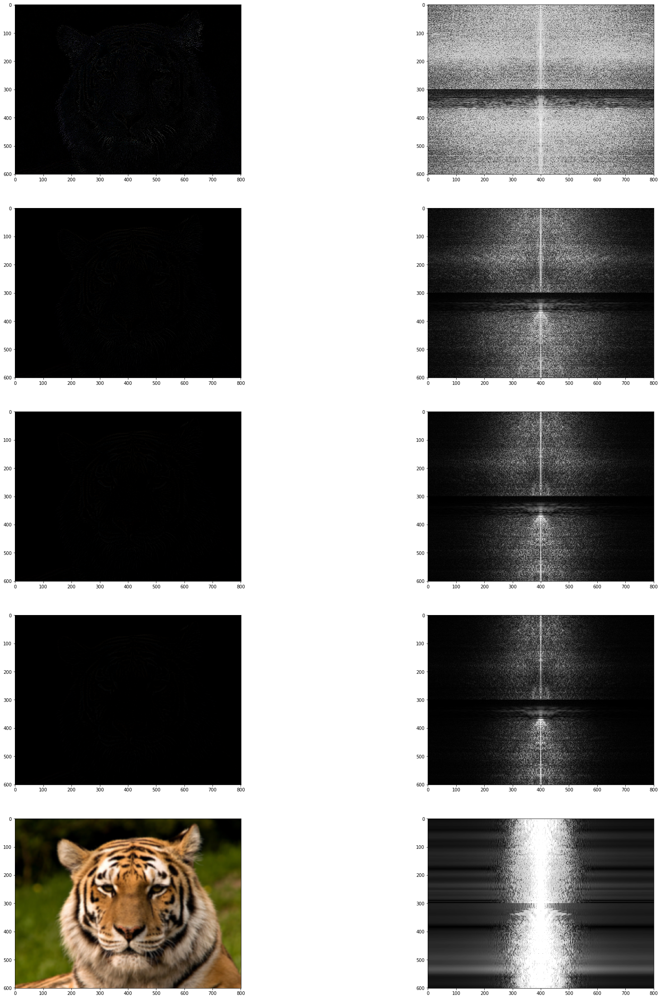

In [9]:
L_pyramide = get_laplas_pyramide(img, 1, n_layers=5)

f, ax = plt.subplots(5, 2, figsize=(30, 40))

for i, curr_img in enumerate(L_pyramide):
    freq = np.log(1 + np.abs(np.fft.fftshift(np.fft.fft2(curr_img))))
    freq = np.clip(freq, 0, max_pix)
    ax[i, 0].imshow(curr_img, cmap='gray')
    ax[i, 1].imshow(rgb2gray(freq), cmap='gray')

Для $\sigma=2$

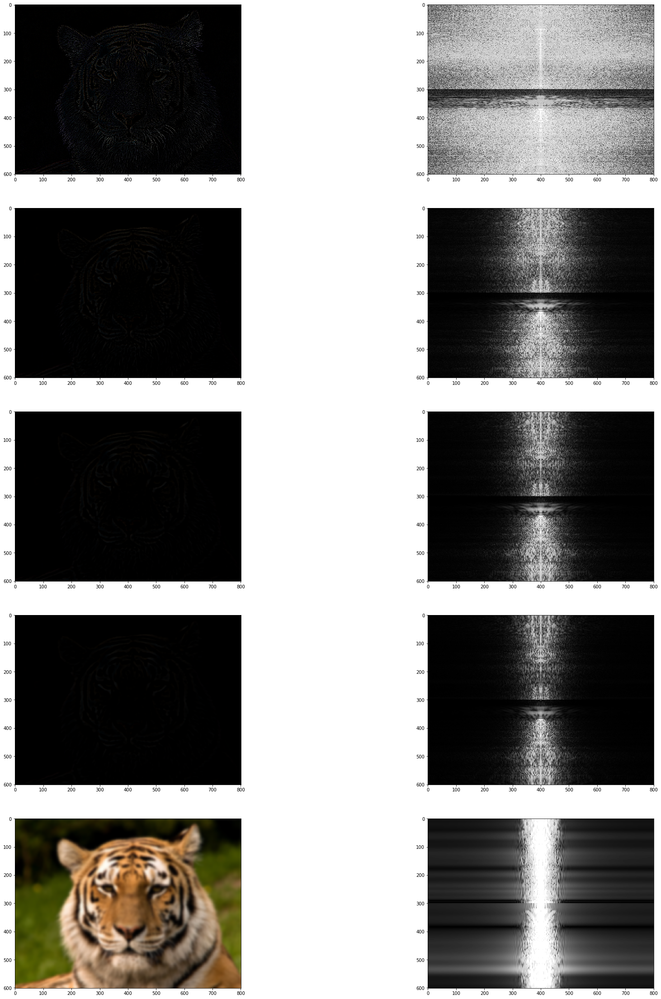

In [10]:
L_pyramide = get_laplas_pyramide(img, 2, n_layers=5)

f, ax = plt.subplots(5, 2, figsize=(30, 40))

for i, curr_img in enumerate(L_pyramide):
    freq = np.log(1 + np.abs(np.fft.fftshift(np.fft.fft2(curr_img))))
    freq = np.clip(freq, 0, max_pix)
    ax[i, 0].imshow(curr_img, cmap='gray')
    ax[i, 1].imshow(rgb2gray(freq), cmap='gray')

Для $\sigma=3$

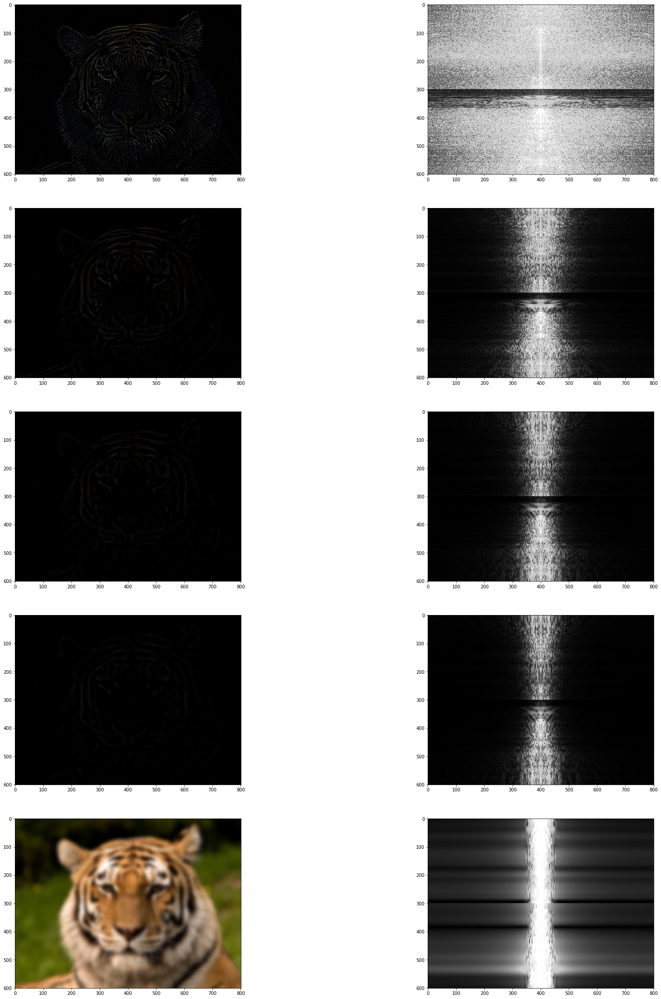

In [11]:
L_pyramide = get_laplas_pyramide(img, 3, n_layers=5)

f, ax = plt.subplots(5, 2, figsize=(30, 40))

for i, curr_img in enumerate(L_pyramide):
    freq = np.log(1 + np.abs(np.fft.fftshift(np.fft.fft2(curr_img))))
    freq = np.clip(freq, 0, max_pix)
    ax[i, 0].imshow(curr_img, cmap='gray')
    ax[i, 1].imshow(rgb2gray(freq), cmap='gray')

C увеличением параметра $\sigma$ появляются все больше видимых линий в слоях, а так же аплитуда частот раширяется

### Склейка двух изображений на основе маски

In [74]:
def gluing_together(a, b, mask, sigma=0.3, n_layers=5):
    la = get_laplas_pyramide(a, sigma, n_layers)
    lb = get_laplas_pyramide(b, sigma, n_layers)
    
    gm = get_gauss_pyramide(mask, sigma, n_layers)
    
    ls = [gm[i] * la[i] + (1 - gm[i]) * lb[i] for i in range(n_layers)]
    
    img = ls[0]
    
    for i in range(1, n_layers):
        img += ls[i]
    
    return np.clip(img, 0, max_pix)

In [75]:
a = img_as_float(imread('a.png'))
b = img_as_float(imread('b.png'))

mask = imread('mask.png')
mask = (mask > 128).astype('uint')

Рассмотрим работу при различных значениях параметра

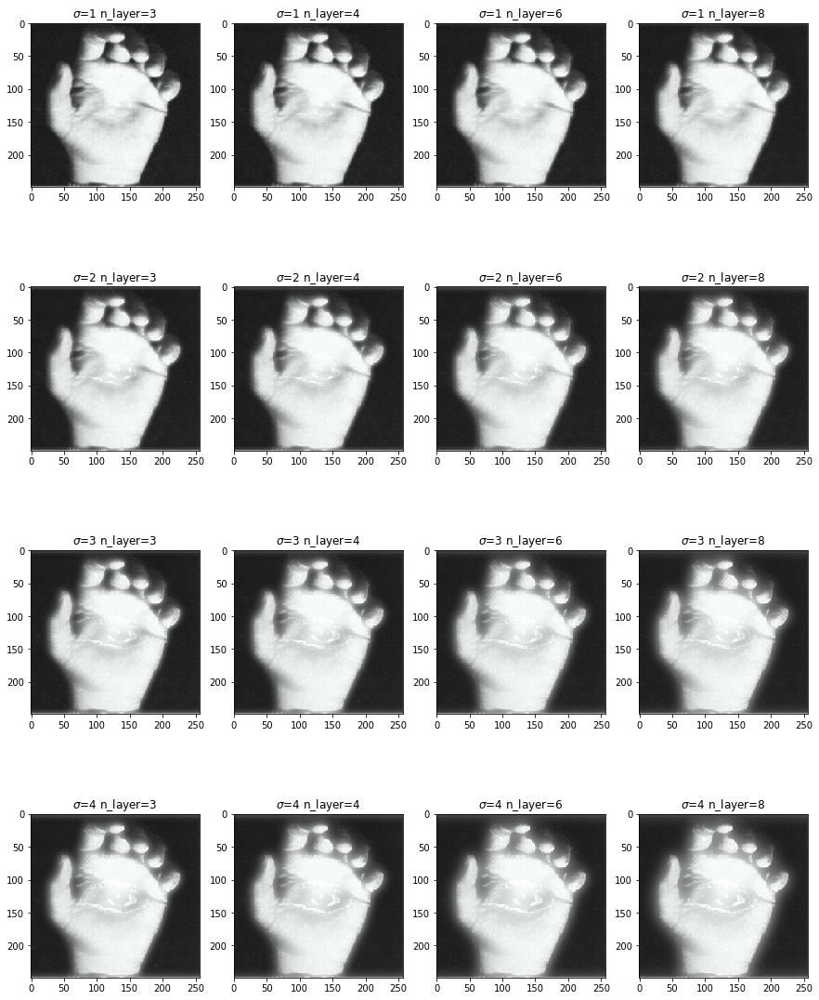

In [76]:
sigmas = [1, 2, 3, 4]
layers = [3, 4, 6, 8]

f, ax = plt.subplots(len(sigmas), len(layers), figsize=(15, 20))

for i, sigma in enumerate(sigmas):
    for j, n_layer in enumerate(layers):
        ax[i][j].imshow(gluing_together(a, b, mask, sigma, n_layer))
        ax[i][j].set_title(fr'$\sigma$={sigma} n_layer={n_layer}')
        
plt.show()

Лучший результат показано при $\sigma=4$, а n_layer=6

In [15]:
# Три набора изображений и масок для склейки и визуализации результата функции

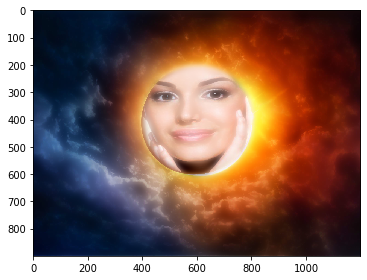

In [16]:
img1 = img_as_float(imread('https://static.toiimg.com/photo/72975551.cms?imgsize=881753'))

mask = np.zeros(img1.shape)

for i in range(len(mask)):
    for j in range(len(mask[0])):
        if ((i - 400) ** 2 + (j - 600) ** 2) < 200 ** 2:
            mask[i][j] = [1, 1, 1]

img2 = imread('https://n1s2.hsmedia.ru/ea/1a/9e/ea1a9e34eeb800cf3813afa5e72da48c/620x600_1_448d62a00bdb2fa7a0e6cc481cb8a561@800x774_0x59f91261_17695716041381417750.jpeg')
img2 = img_as_float(transform.resize(img2, img1.shape))

imshow(gluing_together(img2, img1, mask, 6, 4))

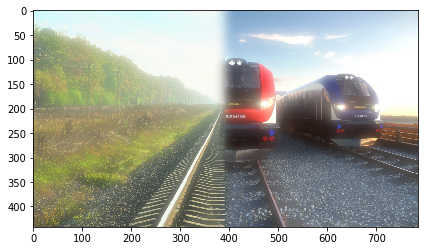

In [17]:
img1 = img_as_float(imread('https://vesti.ua/wp-content/uploads/2019/07/343793.jpeg'))

mask = np.zeros(img1.shape)
for i in range(len(mask)):
    for j in range(len(mask[0])):
        if j >= len(mask[0]) // 2:
            mask[i][j] = 1
            
img2 = imread('https://s2.best-wallpaper.net/wallpaper/2560x1600/1711/Siemens-trains-front-view_2560x1600.jpg')
img2 = img_as_float(transform.resize(img2, img1.shape))

imshow(gluing_together(img2, img1, mask, 6, 4))

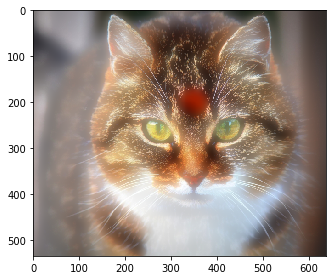

In [18]:
img1 = img_as_float(imread('https://primamedia.gcdn.co/f/main/1878/1877085.jpg?1ec25d2fdb3dbf040899a076bdeee6f6'))

imshow(img1)

mask = np.zeros(img1.shape)
for i in range(len(mask)):
    for j in range(len(mask[0])):
        if ((i - 200) ** 2 + (j - 350) ** 2) < 30 ** 2:
            mask[i][j] = [1, 1, 1]
            
img2 = imread('https://upload.wikimedia.org/wikipedia/commons/thumb/4/4f/Black_hole_-_Messier_87_crop_max_res.jpg/1200px-Black_hole_-_Messier_87_crop_max_res.jpg')
img2 = img_as_float(transform.resize(img2, img1.shape))

imshow(gluing_together(img2, img1, mask, 6, 4))

### Вывод

Мы научились склеивать изображения с помощью пирамид Гауса и Лапласа, а так же с помощью преобразования Фурье оценивать работу фильтров.